In [2]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import os
import mpld3
import umap
import sklearn
from sklearn.manifold import TSNE

%matplotlib inline 
mpld3.enable_notebook()

def load_data(directory):
    data = []
    for file in os.listdir(directory):
        data.append(np.load(directory+"/"+file))
    data = np.array(data)
    return data

weird_points = [1781, 536, 1145, 533, 1720, 1328, 1156, 722, 904, 360, 124, 842, 1859, 2496, 392, 1038, 947, 2322, 156, 2138, 193, 2140, 572, 1414]
def plot_lc(emedded_mat, title, labels=None):
    x = emedded_mat[:, 0]
    y = emedded_mat[:, 1]
    fig, ax = plt.subplots(subplot_kw=dict(axisbg='#EEEEEE'))
    ax.set_xlabel('feature 1')
    ax.set_ylabel('feature 2')
    N = len(x)
    hehe = []
    s = []
    for i in range(N):
        if i in weird_points:
            hehe.append(2)
            s.append(30)
        else:
            hehe.append(0)
            s.append(1)
        
    hehe = np.array(hehe)
    s = np.array(s)
    scatter = ax.scatter(x,
                         y,
                         c=hehe,
                         s=s,
                         alpha=0.3)
    ax.grid(color='white', linestyle='solid')

    ax.set_title(title, size=15)

    if labels is None:
        print "creating labels"
        labels = ['point {0}'.format(i + 1) for i in range(N)]
    tooltip = mpld3.plugins.PointLabelTooltip(scatter, labels=labels)
    mpld3.plugins.connect(fig, tooltip)

In [3]:
kdata = np.load('KeplerSampleFullQ.npy',encoding='bytes')


In [4]:
data = load_data("true_points")
reshaped_data = data.reshape(2500, 784)

0.259721487761
999


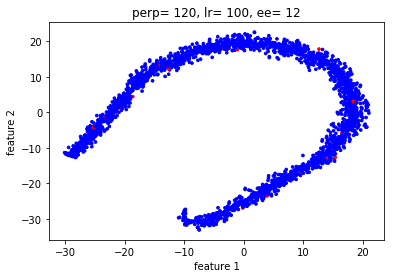

In [17]:
p = 120
ee = 12
lr = 100
model = TSNE(n_components=2, perplexity=p, early_exaggeration=ee, learning_rate=lr)
embeddings = model.fit_transform(reshaped_data)
print model.kl_divergence_
print model.n_iter_
x = embeddings[:, 0]
y = embeddings[:, 1]
colors = ['b' if i not in weird_points else 'r' for i, _ in enumerate(reshaped_data)]
plt.title("perp= " + str(p) + ", lr= " +str(lr) + ", ee= " + str(ee))
plt.xlabel("feature 1")
plt.ylabel("feature 2")
plt.scatter(x, y, c=colors, s=7)
plt.show()

# FINDING HOW STABLE THIS IS

0.260712206364
999


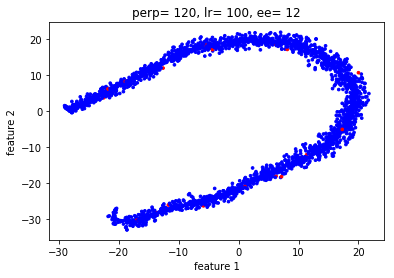

0.259154736996
999


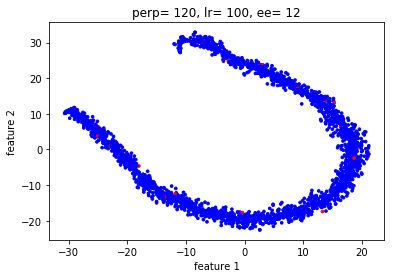

0.260050475597
999


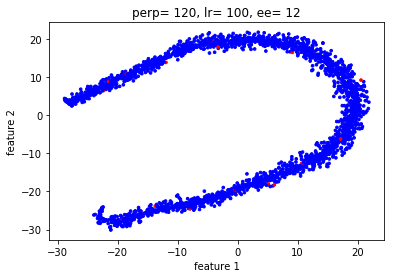

0.260911464691
999


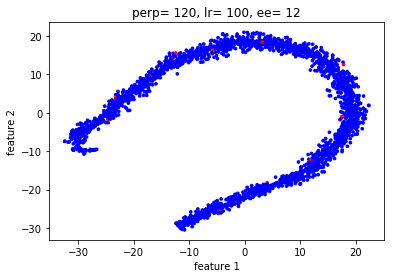

0.263790100813
999


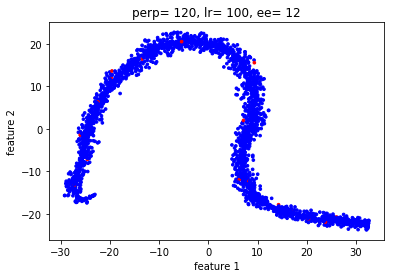

In [22]:
for i in range(5):
    p = 120
    ee = 12
    lr = 100
    model = TSNE(n_components=2, perplexity=p, early_exaggeration=ee, learning_rate=lr)
    embeddings = model.fit_transform(reshaped_data)
    print model.kl_divergence_
    print model.n_iter_
    x = embeddings[:, 0]
    y = embeddings[:, 1]
    colors = ['b' if i not in weird_points else 'r' for i, _ in enumerate(reshaped_data)]
    plt.title("perp= " + str(p) + ", lr= " +str(lr) + ", ee= " + str(ee))
    plt.xlabel("feature 1")
    plt.ylabel("feature 2")
    plt.scatter(x, y, c=colors, s=7)
    plt.show()

# checking dendogram with stable low LK divergence version

In [5]:
from scipy.cluster.hierarchy import cophenet
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import dendrogram, linkage

true_model = TSNE(n_components=2, perplexity=p, early_exaggeration=ee, learning_rate=lr)
embeddings = true_model.fit_transform(reshaped_data)
print true_model.kl_divergence_
print true_model.n_iter_

0.261598855257
999


In [ ]:
z = linkage(reshaped_data, 'ward')
plt.figure(figsize=(200,100))
plt.title('Hierarchical Clustering Dendrogram:')
plt.xlabel('light curve index', fontdict={'size':250})
plt.ylabel('distance', fontdict={'size':250})
dendrogram(
    z,
    leaf_rotation=90.,  # rotates the x axis labels
)
plt.savefig("dendogram/final_dendograms/CHECK_1", format='eps', dpi=1500)

z = linkage(embeddings, 'ward')
plt.figure(figsize=(200,100))
plt.title('Hierarchical Clustering Dendrogram:')
plt.xlabel('light curve index', fontdict={'size':250})
plt.ylabel('distance', fontdict={'size':250})
dendrogram(
    z,
    leaf_rotation=90.,  # rotates the x axis labels
)
plt.savefig("dendogram/final_dendograms/CHECK_2", format='eps', dpi=1500)


In [25]:
z = linkage(embeddings, 'ward')
plt.figure(figsize=(200,100))
plt.title('Hierarchical Clustering Dendrogram:')
plt.xlabel('light curve index', fontdict={'size':250})
plt.ylabel('distance', fontdict={'size':250})
dendrogram(
    z,
    leaf_rotation=90.,  # rotates the x axis labels
)
plt.savefig("dendogram/final_dendograms/CHECK_3", format='eps', dpi=1500)

# weird clustering stuff

In [5]:
p = 120
ee = 12
lr = 100
tsne_model = TSNE(n_components=2, perplexity=p, early_exaggeration=ee, learning_rate=lr)
tsne_embeddings = tsne_model.fit_transform(reshaped_data)

In [6]:
umap_model = umap.UMAP(n_neighbors=70, min_dist=1.0, verbose=True)
x_embedded_umap_first = umap_model.fit_transform(reshaped_data)

UMAP(a=None, angular_rp_forest=False, b=None, init='spectral',
   learning_rate=1.0, local_connectivity=1.0, metric='euclidean',
   metric_kwds=None, min_dist=1.0, n_components=2, n_epochs=None,
   n_neighbors=70, negative_sample_rate=5, random_state=None,
   repulsion_strength=1.0, set_op_mix_ratio=1.0, spread=1.0,
   target_metric='categorical', target_metric_kwds=None,
   target_n_neighbors=-1, target_weight=0.5, transform_queue_size=4.0,
   transform_seed=42, verbose=True)
Construct fuzzy simplicial set
Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs


In [7]:
plot_lc(tsne_embeddings, "")
mpld3.display()

/anaconda/lib/python2.7/site-packages/matplotlib/cbook.py:136: MatplotlibDeprecationWarning: The axisbg attribute was deprecated in version 2.0. Use facecolor instead.
  warnings.warn(message, mplDeprecation, stacklevel=1)


In [8]:
plot_lc(x_embedded_umap_first, "")
mpld3.display()

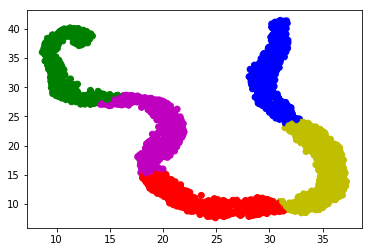

In [9]:
from sklearn.cluster import KMeans
kmeans = KMeans(n_clusters=5, random_state=0).fit(x_embedded_umap_first)
labels = kmeans.labels_

color_map = {0: 'r', 1: 'b', 2: 'g', 3: 'y', 4:'m'}
colors = [color_map[label] for label in labels]
x = x_embedded_umap_first[:, 0]
y = x_embedded_umap_first[:, 1]
plt.scatter(x, y, c=colors)

In [10]:
def lc_indices(cluster_num, labels):
    ans = []
    for i, label in enumerate(labels):
        if label == cluster_num:
            ans.append(i)
    return ans

cluster_0 = lc_indices(0, labels)
cluster_1 = lc_indices(1, labels)
cluster_2 = lc_indices(2, labels)
cluster_3 = lc_indices(3, labels)
cluster_4 = lc_indices(4, labels)

In [11]:
def embed_and_plot_cluster(cluster_indices, true_data):
    new_data = []
    for i, lc in enumerate(true_data):
        if i in cluster_indices:
            new_data.append(lc)
    new_data = np.array(new_data)
    return new_data

cluster_0_original = embed_and_plot_cluster(cluster_0, reshaped_data)

UMAP(a=None, angular_rp_forest=False, b=None, init='spectral',
   learning_rate=1.0, local_connectivity=1.0, metric='euclidean',
   metric_kwds=None, min_dist=1.0, n_components=2, n_epochs=None,
   n_neighbors=70, negative_sample_rate=5, random_state=None,
   repulsion_strength=1.0, set_op_mix_ratio=1.0, spread=1.0,
   target_metric='categorical', target_metric_kwds=None,
   target_n_neighbors=-1, target_weight=0.5, transform_queue_size=4.0,
   transform_seed=42, verbose=True)
Construct fuzzy simplicial set
Construct embedding
	completed  0  /  500 epochs
	completed  50  /  500 epochs
	completed  100  /  500 epochs
	completed  150  /  500 epochs
	completed  200  /  500 epochs
	completed  250  /  500 epochs
	completed  300  /  500 epochs
	completed  350  /  500 epochs
	completed  400  /  500 epochs
	completed  450  /  500 epochs


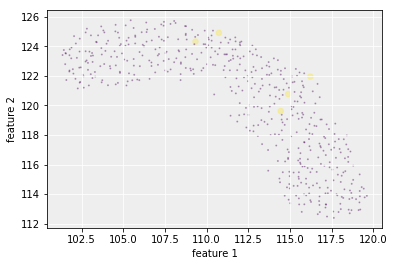

In [14]:
# running umap again on the the things (NOT NUMBER LABELS MEAN NOTHING HERE)
umap_model = umap.UMAP(n_neighbors=70, min_dist=1.0, verbose=True)
x_embedded_umap_second = umap_model.fit_transform(cluster_0_original)
plot_lc(x_embedded_umap_second, "", labels=cluster_0)

0.300189048052
creating labels


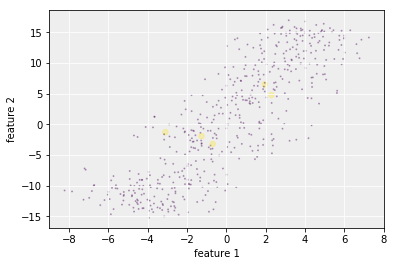

In [17]:
# same thing as above but for tsne
p = 70
ee = 12
lr = 100
tsne_model = TSNE(n_components=2, perplexity=p, early_exaggeration=ee, learning_rate=lr)
tsne_embeddings_second = tsne_model.fit_transform(cluster_0_original)
print tsne_model.kl_divergence_
plot_lc(tsne_embeddings_second, "")

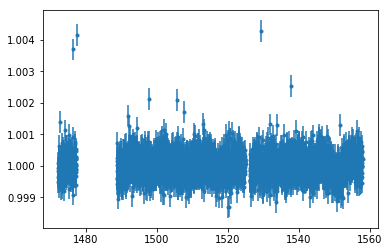

In [11]:
def real_plot(num):
    x = kdata[num][0]
    y = kdata[num][1]
    y_err = kdata[num][2]
#     plt.plot(x, y, ".")
    plt.errorbar(x, y, yerr=y_err,fmt=".")
    
    plt.show()
    
real_plot(388)

# different ways of coming to tsne/umap (try pca first?)

In [33]:
from sklearn.decomposition import PCA
from scipy.cluster.hierarchy import cophenet
from scipy.spatial.distance import pdist
from scipy.cluster.hierarchy import dendrogram, linkage

pca_model = PCA(n_components=30)
pca_embeddings = pca_model.fit_transform(reshaped_data)

# z = linkage(pca_embeddings, 'ward')
# plt.figure(figsize=(200,100))
# plt.title('Hierarchical Clustering Dendrogram: PCA')
# plt.xlabel('light curve index', fontdict={'size':250})
# plt.ylabel('distance', fontdict={'size':250})
# dendrogram(
#     z,
#     leaf_rotation=90.,  # rotates the x axis labels
# )
# plt.savefig("dendogram/final_dendograms/CHECK_4", format='eps', dpi=1500)

# now run umap/tsne

p = 120
ee = 12
lr = 100
tsne_model = TSNE(n_components=2, perplexity=p, early_exaggeration=ee, learning_rate=lr)
tsne_embeddings = tsne_model.fit_transform(pca_embeddings)
print tsne_model.kl_divergence_

0.237321943045


In [ ]:
plot_lc

# ouliter finding

In [4]:
p = 120
ee = 12
lr = 100
tsne_model = TSNE(n_components=2, perplexity=p, early_exaggeration=ee, learning_rate=lr)
tsne_embeddings = tsne_model.fit_transform(reshaped_data)

In [24]:
from sklearn.metrics import pairwise_distances

In [25]:
distances = pairwise_distances(tsne_embeddings)

In [36]:
def real_plot(num):
    x = kdata[num][0]
    y = kdata[num][1]
    plt.plot(x, y)
    plt.show()

def find_outliers(distances, metric='average', name="test"):
    if metric == 'average':
        distribution = np.mean(distances, axis=1)
        average = np.mean(distribution)
        normalized = np.apply_along_axis(lambda x: (x-average)/std, 0, distribution)
        plt.title("distance distribution for embedding: " + name)
        plt.hist(normalized, bins=100)
        plt.show()
        outliers = [i for i, _ in enumerate(normalized) if normalized[i] > 3]
        for i in outliers:
            plt.title("outlier " + str(i) + " for embeddings: " + name)
            real_plot(i)
        return outliers

In [8]:
distribution = np.mean(distances, axis=1)

In [9]:
average = np.mean(distribution)
std = np.std(distribution)
std

2.73001

In [10]:
normalized = np.apply_along_axis(lambda x: (x-average)/std, 0, distribution)
normalized

array([ 2.186067  , -0.5650014 , -0.76310784, ..., -0.6810991 ,
       -0.7356351 , -1.086282  ], dtype=float32)

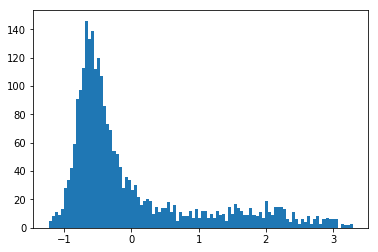

In [11]:
plt.hist(normalized, bins=100)
plt.show()

In [12]:
outliers = [i for i, _ in enumerate(normalized) if normalized[i] > 3]
outliers

[24,
 110,
 155,
 210,
 230,
 296,
 308,
 407,
 651,
 700,
 815,
 1105,
 1338,
 1382,
 1434,
 1502,
 1508,
 1912,
 2034,
 2041,
 2197,
 2387]

In [13]:
def real_plot(num):
    x = kdata[num][0]
    y = kdata[num][1]
    plt.plot(x, y)
    plt.show()


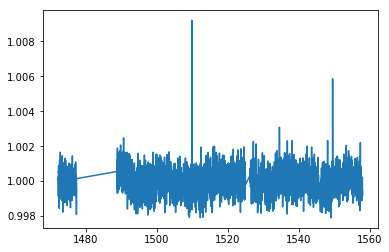

In [47]:
real_plot(2395)

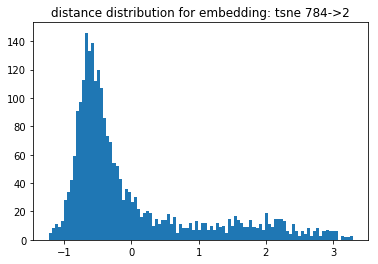

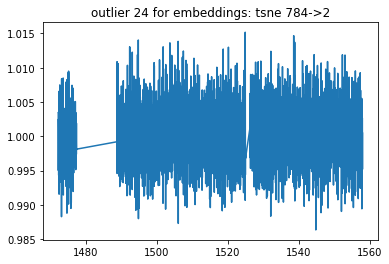

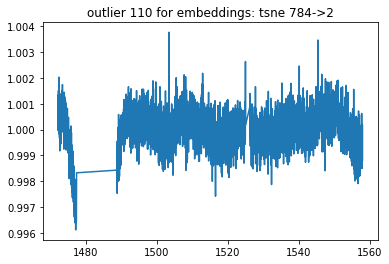

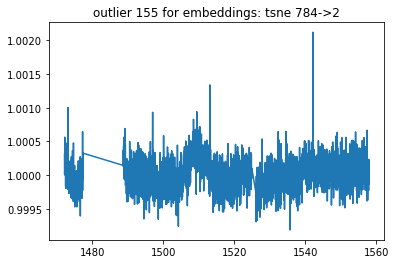

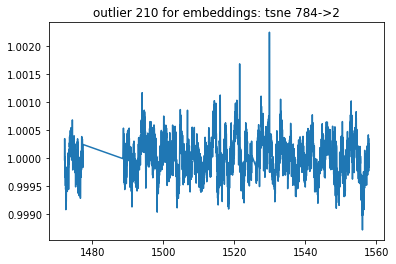

...

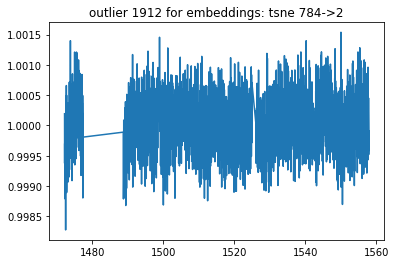

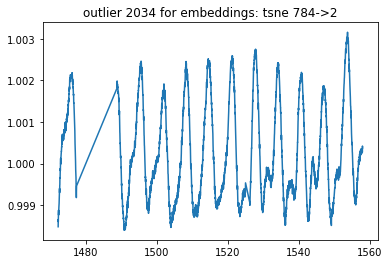

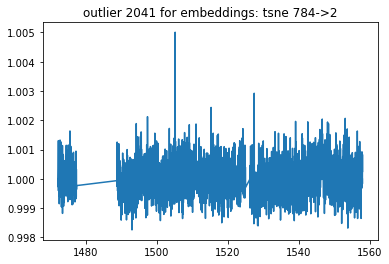

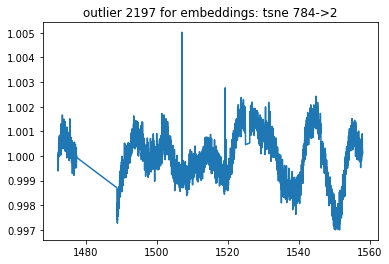

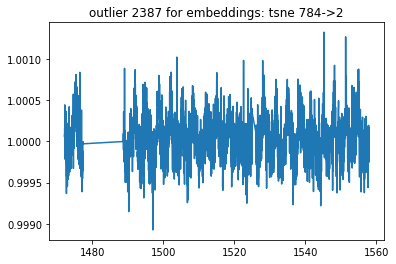

[24,
 110,
 155,
 210,
 230,
 296,
 308,
 407,
 651,
 700,
 815,
 1105,
 1338,
 1382,
 1434,
 1502,
 1508,
 1912,
 2034,
 2041,
 2197,
 2387]

In [37]:
find_outliers(distances, name="tsne 784->2")

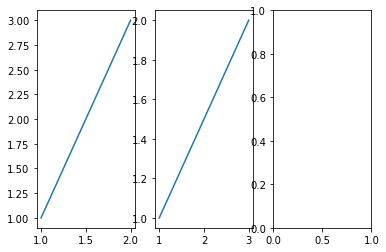

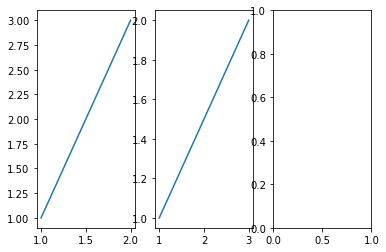

In [29]:
# TSNE ONES
x = [1,2]
y = [1,3]
plt.subplot(1,3,1)
plt.plot(x,y)
plt.subplot(1,3,2)
plt.plot(y,x)
plt.subplot(1,3,3)
plt.show()
plt.subplot(1,3,1)
plt.plot(x,y)
plt.subplot(1,3,2)
plt.plot(y,x)
plt.subplot(1,3,3)
plt.show()

In [ ]:
# UMAP ONES
p = 120
ee = 12
lr = 100
model = umap.UMAP(n_neighbors=70, min_dist=1.0, verbose=True)
embeddings = tsne_model.fit_transform(reshaped_data)
umap_model = umap.UMAP(n_neighbors=70, min_dist=1.0, verbose=True)
x_embedded_umap_first = umap_model.fit_transform(reshaped_data)



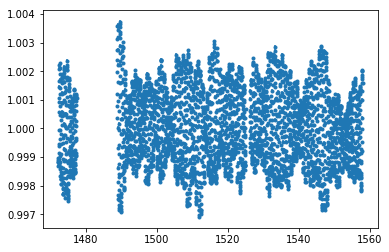

In [12]:
real_plot(45)

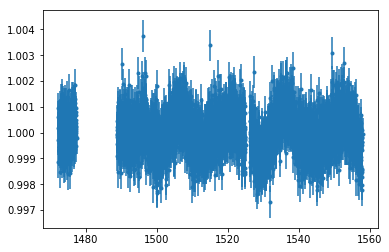

In [13]:
real_plot(260)

In [14]:
new_data = load_data("true_points")
new_data.shape


(2500, 28, 28)

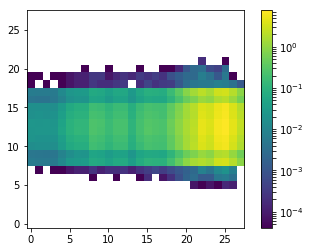

In [16]:

# fastdmdt = get2dhist(new_data[260])
plt.imshow(new_data[260],  norm = LogNorm(), origin="lower")
plt.colorbar()

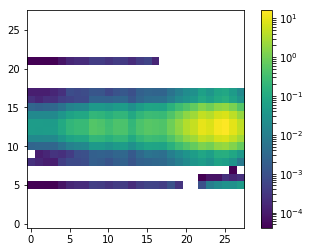

In [21]:
plt.imshow(new_data[45],  norm = LogNorm(), origin="lower")
plt.colorbar()

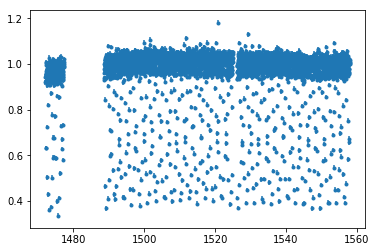

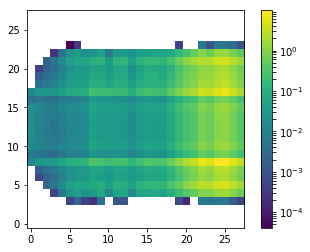

In [23]:
real_plot(1781)
plt.imshow(new_data[1781],  norm = LogNorm(), origin="lower")
plt.colorbar()